#### Importação das Bibliotecas

In [1]:
#Bibliotecas
import numpy as np
import pandas as pd
import networkx as nx
import pylab as plt
from networkx.drawing.nx_agraph import graphviz_layout

#### Definição das Classes

Obs: Esta parte está sendo construída para criar qualquer grafo e ser utilizado nas buscas por profundidade, largura, gulosa e demais exemplos de grafos sem bibliotecas nativas como Networkx e Igraph

Obs: Falta finalizar a lógica de percorrer todos os vértices (profundidade, largura ou gulosa) e desenhar.

In [2]:
#Classes
class Vertice:
    #Construtor da Classe
    def __init__(self, rotulo):
        self.rotulo = rotulo       #Atributo que recebe o parametro rotulo
        self.visitado = False      #Atributo inicialmente falso para controlar as buscas no grafo de vertices visitados
        self.adjacentes = []
    
    #Funcao para adicionar o adjacente
    def adiciona_adjacente(self, adjacente):
        self.adjacentes.append(adjacente)
    
    #Funcao para mostrar adjacentes
    def mostra_adjacentes(self):
        for i in self.adjacentes:
            print(i.vertice.rotulo, i.custo)
            
class Adjacente:
    #Construtor da Classe
    def __init__(self, vertice, custo):
        self.vertice = vertice     #Atributo que recebe o parametro vertice
        self.custo = custo         #Atributo que recebe o parametro custo
        
class Grafo:
    #Classe para criar o Grafo, como cada Grafo é único é complexo criar uma função para abstrair a inserção dos vertices 
    CE = Vertice('CE')
    RN = Vertice('RN')
    PB = Vertice('PB')
    PE = Vertice('PE')
    AL = Vertice('AL')
    SE = Vertice('SE')
    BA = Vertice('BA')
    PI = Vertice('PI')
    MA = Vertice('MA')
    ES = Vertice('ES')
    RJ = Vertice('RJ')
    MG = Vertice('MG')
    SP = Vertice('SP')
    PR = Vertice('PR')
    SC = Vertice('SC')
    RS = Vertice('RS')
    TO = Vertice('TO')
    GO = Vertice('GO')
    DF = Vertice('DF')
    MS = Vertice('MS')
    MT = Vertice('MT')
    PA = Vertice('PA')
    AP = Vertice('AP')
    RR = Vertice('RR')
    AM = Vertice('AM')
    AC = Vertice('AC')
    RO = Vertice('RO')
    
    #Adiciona as Arestas de cada vertice criando o objeto e repassando também o custo.
    CE.adiciona_adjacente(Adjacente(PI,10))
    CE.adiciona_adjacente(Adjacente(RN,10))
    CE.adiciona_adjacente(Adjacente(PB,10))
    CE.adiciona_adjacente(Adjacente(PE,10))
    RN.adiciona_adjacente(Adjacente(PB,10))
    PB.adiciona_adjacente(Adjacente(PE,10))
    PE.adiciona_adjacente(Adjacente(AL,10))
    PE.adiciona_adjacente(Adjacente(PI,10))
    AL.adiciona_adjacente(Adjacente(SE,10))
    SE.adiciona_adjacente(Adjacente(BA,10))
    BA.adiciona_adjacente(Adjacente(ES,10))
    BA.adiciona_adjacente(Adjacente(MG,10))
    BA.adiciona_adjacente(Adjacente(GO,10))
    BA.adiciona_adjacente(Adjacente(TO,10))
    BA.adiciona_adjacente(Adjacente(PI,10))
    ES.adiciona_adjacente(Adjacente(RJ,10))
    ES.adiciona_adjacente(Adjacente(MG,10))
    RJ.adiciona_adjacente(Adjacente(MG,10))   
    RJ.adiciona_adjacente(Adjacente(SP,10))
    MG.adiciona_adjacente(Adjacente(SP,10))
    MG.adiciona_adjacente(Adjacente(GO,10))
    MG.adiciona_adjacente(Adjacente(MS,10))
    SP.adiciona_adjacente(Adjacente(PR,10))
    SP.adiciona_adjacente(Adjacente(MS,10))
    PR.adiciona_adjacente(Adjacente(SC,10))
    PR.adiciona_adjacente(Adjacente(MS,10))
    SC.adiciona_adjacente(Adjacente(RS,10))
    MS.adiciona_adjacente(Adjacente(GO,10))
    MS.adiciona_adjacente(Adjacente(MT,10))
    GO.adiciona_adjacente(Adjacente(MT,10))
    GO.adiciona_adjacente(Adjacente(DF,10))
    GO.adiciona_adjacente(Adjacente(TO,10))
    MT.adiciona_adjacente(Adjacente(RO,10))
    MT.adiciona_adjacente(Adjacente(TO,10))
    MT.adiciona_adjacente(Adjacente(PA,10))
    MT.adiciona_adjacente(Adjacente(AM,10))
    TO.adiciona_adjacente(Adjacente(MA,10))
    TO.adiciona_adjacente(Adjacente(PI,10))
    TO.adiciona_adjacente(Adjacente(PA,10))
    MA.adiciona_adjacente(Adjacente(PI,10))
    MA.adiciona_adjacente(Adjacente(PA,10))
    PA.adiciona_adjacente(Adjacente(AP,10))
    PA.adiciona_adjacente(Adjacente(RR,10))
    PA.adiciona_adjacente(Adjacente(AM,10))
    AM.adiciona_adjacente(Adjacente(RR,10))
    AM.adiciona_adjacente(Adjacente(AC,10))
    AM.adiciona_adjacente(Adjacente(RO,10))
    AC.adiciona_adjacente(Adjacente(RO,10))
    PE.adiciona_adjacente(Adjacente(BA,10))
    BA.adiciona_adjacente(Adjacente(AL,10))


#### Criando Objetos

In [5]:
#Criando o objeto grafo
grafo = Grafo()

grafo.CE.mostra_adjacentes()
    

PI 10
RN 10
PB 10
PE 10


### Utilizando NetworkX

Realmente é uma biblioteca que facilitada bastante a resolução de problemas envolvendo Grafos

Nro. Mínimo de Cores: 4


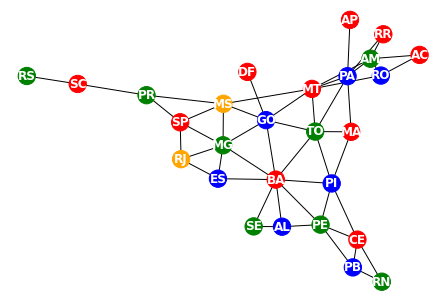

In [89]:
# Networkx possui funções greedy_color que implementa o preenchimento de cor dos vértices do 
# grafo utiliznado uma lógica Gulosa previamente escolhida ou passando uma função criada.

# Cria a função para colorir os vertices conforme descrito nos Tutoriais da Networkx
# https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.coloring.greedy_color.html#networkx.algorithms.coloring.greedy_color
def pintavertices(G):
    # Definicao de variaveis
    colorpalette = {0:'red', 1:"green", 2:"blue", 3:"orange", 4:"pink", 5:"yellow"}
    mapadecor = []

    # Chama a função greedy_color passando a Estratégia "largest_First" que segundo a documentação implementa
    # um preenchimento de cor gulosa, baseado no grau de cada vértice em ordem descrescente de grau
    g_color = nx.coloring.greedy_color(G, strategy="largest_first")
    
    #Exibe o Nro. Cromático para aferição
    chromaticnumber = max(g_color.values())+1
    print("Nro. Mínimo de Cores:", chromaticnumber)
    
    # Preenchimento das cortes de cada vértice, precisamos criar um laço para facilitar o preenchimento
    for node in G:
        mapadecor.append(colorpalette[g_color[node]])
    return mapadecor

# Criação do Grafo
G = nx.Graph()

# Criação de todos os vértices.
V = ["CE", "RN", "PB", "PE","AL", "SE", "BA", "PI", "MA", "ES", "RJ", "MG", "SP","PR", "SC", "RS", "TO", "GO", "DF", "MS",
     "MT", "PA", "AP", "RR","AM", "AC", "RO"]
# Criação de toas as arestas, com apoio de outros colegas que já haviam desenhando os vértices.
E = [("CE", "PI"), ("CE","RN"), ("CE", "PB"), ("CE", "PE"), ("RN", "PB"), ("PB", "PE"), ("PE", "AL"), ("PE","PI"), ("AL", "SE"),
     ("SE", "BA"), ("BA", "ES"), ("BA","MG"), ("BA", "GO"), ("BA", "TO"), ("BA", "PI"), ("ES", "RJ"), ("ES", "MG"), ("RJ","MG"),
     ("RJ", "SP"), ("MG", "SP"), ("MG", "GO"), ("MG", "MS"), ("SP", "PR"), ("SP","MS"), ("PR", "SC"), ("PR", "MS"), ("SC", "RS"),
     ("MS", "GO"), ("MS", "MT"), ("GO", "MT"), ("GO", "DF"), ("GO", "TO"), ("MT","RO"), ("MT", "TO"), ("MT", "PA"), ("MT", "AM"),
     ("TO", "MA"), ("TO", "PI"), ("TO", "PA"), ("MA", "PI"), ("MA", "PA"), ("PA","AP"), ("PA", "RR"), ("PA", "AM"), ("AM", "RR"),
     ("AM", "AC"), ("AM", "RO"), ("AC", "RO"), ("PE","BA"), ("BA","AL")]
# Adicionando os vérticees ao grafo.
G.add_nodes_from(V)
# Adicionando as Arestas ao Grafo
G.add_edges_from(E)


# Mostra o grafo colorido
mapadecor=pintavertices(G)
nx.draw(G, pos=nx.spring_layout(G), with_labels=True, font_weight='bold', font_color="w", node_color=mapadecor)

#### Exemplo Utilizando a Biblioteca IGraph

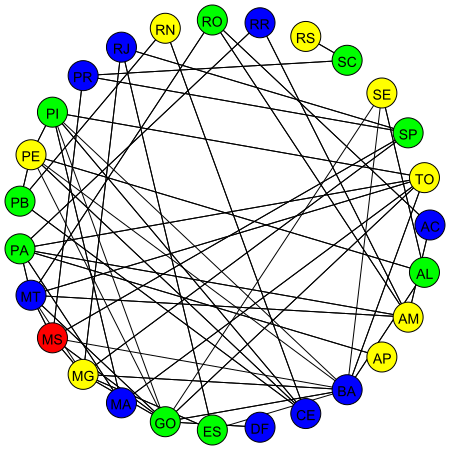

In [6]:
##Importando a biblioteca
from igraph import *

##Criando o Grafo
g=Graph(directed=False)

##Adicionando os 26 Vertices que representam os 26 estados 
g.add_vertices(27)

#Definindo o Layout do Gráfico
layout = g.layout("circle")

##Criando o Estilo
visual_style = {}
##Layout
visual_style["layout"] = layout
visual_style["margin"] = 20
visual_style["vertex_size"] = 30
visual_style["vertex_shape"] = 'circle'
visual_style["bbox"] = (450, 450)
visual_style["edge_curved"] = 0
visual_style["edge_color"] = 'black'

##Definindo os nomes dos vertices
visual_style["vertex_label"] = ['AC', 'AL', 'AM', 'AP', 'BA', 'CE', 'DF', 'ES', 'GO', 'MA', 'MG', 'MS', 'MT',
                                'PA', 'PB', 'PE', 'PI', 'PR', 'RJ', 'RN', 'RO', 'RR', 'RS', 'SC', 'SE', 'SP', 'TO']

##Definindo as cores do mapa
g.vs['color'] = ['blue','green','yellow','yellow','blue','blue','blue','green','green','blue','yellow','red',
                 'blue','green','green','yellow','green','blue','blue','yellow','green','blue','yellow','green',
                 'yellow','green','yellow']

'''
Relação Labels e Vértices

0 - AC
1 - AL
2 - AM
3 - AP
4 - BA
5 - CE
6 - DF
7 - ES
8 - GO
9 - MA
10 - MG
11 - MS
12 - MT
13 - PA
14 - PB
15 - PE
16 - PI
17 - PR
18 - RJ
19 - RN
20 - RO
21 - RR
22 - RS
23 - SC
24 - SE
25 - SP
26 - TO

Relação de Areas baseado na análise visual do mapa do Brasil e a relação das arestas

'AC': ["AM", "RO"],
'AL': ['PE', "SE", "BA"],
'AM': ['AC', "RR", "RO", "MT", "PA"],
"AP": ["PA"],
"BA": ["SE", "AL", "PE", "PI", "TO", "GO", "MG", "ES"],
"CE": ["RN", "PB", "PE", "PI"],
"DF": ["GO"],
"ES": ["MG", "RJ", "BA"],
"GO": ["DF", "TO", "BA", "MG", "MS", "MT"],
"MA": ["PI", "TO", "PA"],
"MG": ["ES", "RJ", "SP", "GO", "BA", "MS", "DF"],
"MS": ["PR", "SP", "MG", "GO", "MT"],
"MT": ["RO", "AM", "PA", "TO", "GO", "MS"],
"PA": ["AP", "MA", "TO", "MT", "AM", "RR"],
"PB": ["CE", "RN", "PE"],
"PE": ["PB", "CE", "PI", "AL", "BA"],
"PI": ["CE", "PE", "BA", "TO", "MA"],
"PR": ["SP", "SC", "MS"],
"RJ": ["MG", "ES", "SP"],
"RN": ["PB", "CE"],
"RO": ["AC", "AM", "MT"],
"RR": ["AM", "PA"],
"RS": ["SC"],
"SC": ["PR", "RS"],
"SE": ["BA", "AL"],
"SP": ["MG", "RJ", "PR", "MS"],
"TO": ["MA", "PI", "BA", "GO", "MT", "PA"]

'''


##Criando as Arestas de cada estado baseado em uma análise visual do mapa do Brasil e a relação das arestas
g.add_edges([
            ## 0 - AC
            (0,2),(0,20),
            ## 1 - AL
            (1,15),(1,24),(1,4),
            ## 2 - AM
            (2,0),(2,21),(2,20),(2,12),(2,13),
            ## 3 - AP
            (3,13),
            ## 4 - BA
            (4,24),(4,1),(4,15),(4,16),(4,26),(4,8),(4,10),(4,11),
            ## 5 - CE
            (5,19),(5,14),(5,15),(5,16),
            ## 6 - DF
            (6,8),
            ## 7 - ES
            (7,10),(7,18),(7,4),
            ## 8 - GO
            (8,6),(8,26),(8,4),(8,10),(8,11),(8,12),
            ## 9 - MA
            (9,16),(9,26),(9,13),
            ## 10 - MG
            (10,7),(10,18),(10,25),(10,8),(10,4),(10,11),(10,12),
            ## 11 - MS
            (11,17),(11,25),(11,10),(11,8),(11,12),
            ## 12 - MT
            (12,20),(12,2),(12,13),(12,26),(12,8),(12,11),
            ## 13 - PA
            (13,3),(13,9),(13,26),(13,12),(13,2),(13,21),
            ## 14 - PB
            (14,5),(14,19),(14,15),
            ## 15 - PE
            (15,14),(15,5),(15,16),(15,1),(15,8),
            ## 16 - PI
            (16,5),(16,15),(16,8),(16,26),(16,9),
            ## 17 - PR
            (17,25),(17,23),(17,11),
            ## 18 - RJ
            (18,10),(18,7),(18,25),
            ## 19 - RN
            (19,14),(19,5),
            ## 20 - RO
            (20,0),(20,2),(20,12),
            ## 21 - RR
            (21,2),(21,13),
            ## 22 - RS
            (22,23),
            ## 23 - SC
            (23,17),(23,22),
            ## 24 - SE
            (24,8),(24,1),
            ## 25 - SP
            (25,10),(25,18),(25,17),(25,11),
            ## 26 - TO
            (26,9),(26,16),(26,4),(26,8),(26,12),(26,13)
            ])




##Plotar o Grafo
plot(g, **visual_style)

#### Grafos plotados em um Mapa Interativo com Folium - Leaflet.js - Cartopy - Dados abertos do Governo

O arquivo que iremos usar aqui para fazer esta análise vem diretamente da base de dados abertos do Governo e esta licenciado sobre a Creative Commons (CC BY-SA 3.0). Portanto, podemos copiar, transformar e redistribuir o material em qualquer suporte ou formato porém, não se esquecendo de dar o devido crédito. Feito!

Obs: Ainda precisa ser incluído para construção e desenho do grafo recursivamente, mas é um bom exemplo de como construir um grafo para Mapas, com opções interativas

In [7]:
##Importando as biblioteca
## Biblioteca Igraph para criação de grafos.
from igraph import *
## Biblioteca colormap para mapeamento de cores
from branca.colormap import linear
## Biblioteca Folium
import folium
## Biblioteca Json
import json
## Biblioteca Pandas :)
import pandas as pd

## Importando o arquivo Json do Governo e criando o formato GeoJson salvo na pasta do projeto
br_estados = 'br_states.json'
geo_json_data = json.load(open(br_estados))

'''
Ex:

{
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "geometry": {
        "type": "Point",
        "coordinates": [102.0, 0.5]
      },
      "properties": {
        "prop0": "value0"
      }
    }
  ]
}
'''

##Colormap
colormap = linear.YlOrRd_09.scale(6,20)
colormap

##Criacao do mapa interativo com Folium
mapa = folium.Map(
    width=600,height=400,
    location=[-15.77972, -47.92972], 
    zoom_start=3
)

'''
##Definindo os nomes dos vertices
visual_style["vertex_label"] = ['AC', 'AL', 'AM', 'AP', 'BA', 'CE', 'DF', 'ES', 'GO', 'MA', 'MG', 'MS', 'MT',
                                'PA', 'PB', 'PE', 'PI', 'PR', 'RJ', 'RN', 'RO', 'RR', 'RS', 'SC', 'SE', 'SP', 'TO']

##Definindo as cores do mapa
g.vs['color'] = ['blue','green','yellow','yellow','blue','blue','blue','green','green','blue','yellow','red',
                 'blue','green','green','yellow','green','blue','blue','yellow','green','blue','yellow','green',
                 'yellow','green','yellow']
'''

## Leitura do objeto criado GeoJson sobrepondo no mapa
folium.GeoJson(
    geo_json_data,
    style_function=lambda feature: {
        'fillColor': 'blue' if feature['id'] == 'AC'
                            else 'green' if feature['id'] == 'AL'
                            else 'yellow' if feature['id'] == 'AM'
                            else 'yellow' if feature['id'] == 'AP'
                            else 'blue' if feature['id'] == 'BA'
                            else 'blue' if feature['id'] == 'CE'
                            else 'blue' if feature['id'] == 'DF'
                            else 'green' if feature['id'] == 'ES'
                            else 'green' if feature['id'] == 'GO'
                            else 'blue' if feature['id'] == 'MA'
                            else 'yellow' if feature['id'] == 'MG'
                            else 'red' if feature['id'] == 'MS'
                            else 'blue' if feature['id'] == 'MT'
                            else 'green' if feature['id'] == 'PA'
                            else 'green' if feature['id'] == 'PB'
                            else 'yellow' if feature['id'] == 'PE'
                            else 'green' if feature['id'] == 'PI'
                            else 'blue' if feature['id'] == 'PR'
                            else 'blue' if feature['id'] == 'RJ'
                            else 'yellow' if feature['id'] == 'RN'
                            else 'green' if feature['id'] == 'RO'
                            else 'blue' if feature['id'] == 'RR'
                            else 'yellow' if feature['id'] == 'RS'
                            else 'green' if feature['id'] == 'SC'
                            else 'yellow' if feature['id'] == 'SE'
                            else 'green' if feature['id'] == 'SP'
                            else 'yellow' if feature['id'] == 'TO'
                            else 'white'
        ,
        'color': 'darkred',
        'weight': 0.5,
    }
).add_to(mapa)

## Criando o mapa interativo com a menor quantidade de cores baseado no grafo que é 4 cores.
mapa